In [1]:
import os
from PIL import Image, ImageFile
import matplotlib.pyplot as plt
import numpy as np
from tqdm import tqdm
%matplotlib inline

ImageFile.LOAD_TRUNCATED_IMAGES = True

base = "../scraped/filtered"

In [4]:
files = None
for (dirname, dirnames, filenames) in os.walk(base):
    files = filenames
    break

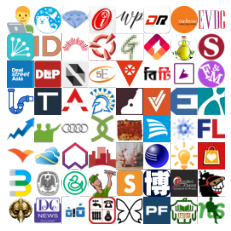

In [3]:
chosen = np.random.choice(files, size=(8, 8))

images = []
for i, cols in enumerate(chosen):
    col_im = []
    for j, path in enumerate(cols):
        image = Image.open(os.path.join(base, path))
        col_im.append(np.array(image))
    
    col_im = np.concatenate(col_im, axis=0)
    images.append(col_im)
images = np.concatenate(images, axis=1)

plt.imshow(images)
plt.axis('off')
plt.show()

In [5]:
import tensorflow as tf

In [6]:
# http://www.robots.ox.ac.uk/~vgg/research/very_deep/
vgg16 = tf.keras.applications.VGG16(include_top=False, input_shape=(32, 32, 3))

In [7]:
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.applications.vgg16 import preprocess_input

image = load_img(os.path.join(base, files[0]))
image = img_to_array(image)
image = image.reshape(1, *image.shape)
image = preprocess_input(image)

vgg16.predict(image).shape

(1, 1, 1, 512)

In [8]:
images = []
for path in tqdm(files):
    image = load_img(os.path.join(base, path))
    image = img_to_array(image)
    images.append(image)

images = np.stack(images)
raw_images = images

images = preprocess_input(images)


100%|██████████| 131274/131274 [00:56<00:00, 2340.93it/s]


In [24]:
print(len(files))
print(images.shape)

131274
(131274, 32, 32, 3)


In [27]:
labels = vgg16.predict(images)

In [30]:
print(labels.shape)
labels = labels.reshape(labels.shape[0], labels.shape[3])
print(labels.shape)

(131274, 1, 1, 512)
(131274, 512)


In [122]:
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans


pca = PCA(128)
reduced_labels = pca.fit_transform(labels)
reduced_labels.shape

(131274, 128)

In [123]:
kmeans = KMeans(128)
kmeans.fit(reduced_labels)

KMeans(n_clusters=128)

In [133]:
cluster_distanced = kmeans.transform(reduced_labels)
clustered = kmeans.predict(reduced_labels)

(512, 4096, 4)


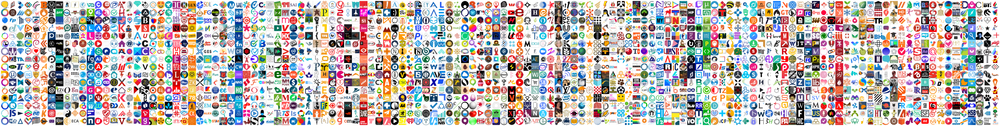

In [127]:
n_icons = 16
n_clusters = 128
chosen = []
for i in range(128):
    indices = np.where(clustered == i)
    loaded_images = []
    for idx in np.random.choice(indices[0], n_icons):
        loaded_images.append(np.array(Image.open(os.path.join(base, files[idx]))))
    chosen.append(np.concatenate(loaded_images, axis=0))
    #print(chosen[i].shape)

chosen = np.concatenate(chosen, axis=1)
print(chosen.shape)

plt.figure(figsize=(n_clusters, n_icons))
ax = plt.gca()
ax.axis('off')
ax.patch.set_visible(False)
fig = plt.gcf()
fig.patch.set_visible(False)

plt.imshow(chosen)
#plt.show()
plt.savefig('../tst.png')

In [128]:
kmeans.get_params()

{'algorithm': 'auto',
 'copy_x': True,
 'init': 'k-means++',
 'max_iter': 300,
 'n_clusters': 128,
 'n_init': 10,
 'n_jobs': 'deprecated',
 'precompute_distances': 'deprecated',
 'random_state': None,
 'tol': 0.0001,
 'verbose': 0}

In [130]:
import pickle

In [132]:
pickle.dump(pca, open("../scraped/pca.pickle", "wb"))
pickle.dump(kmeans, open("../scraped/kmeans.pickle", "wb"))

In [139]:
np.save(open('../scraped/clustered.npy', 'wb'), clustered)

In [2]:
clustered = np.load(open('../scraped/clustered.npy', 'rb'))

In [5]:
raw_images = list(map(lambda x: np.array(Image.open(os.path.join('../scraped/filtered', x)).convert('RGBA')), files))

In [6]:
idxs = np.arange(len(raw_images))
np.random.shuffle(idxs)
idxs

array([ 88221,   1879,  83764, ...,  70332, 106484,  42710])

In [7]:
segment_length = 1024 ** 3 // (32 * 32 * 3)
sn = 0
kn = 0
segment = []

folder = 'icon'
os.mkdir("../scraped/" + folder + "-npy-" + str(32))
for idx in idxs:
    sample = np.array([raw_images[idx], clustered[idx]])
    segment.append(sample)
    kn = kn + 1

    if kn >= segment_length:
        np.save("../scraped/" + folder + "-npy-" + str(32) + "/data-"+str(sn)+".npy", np.array(segment))

        segment = []
        kn = 0
        sn = sn + 1

np.save("../scraped/" + folder + "-npy-" + str(32) + "/data-"+str(sn)+".npy", np.array(segment))